In [1]:
from __future__ import absolute_import, division, print_function, unicode_literals

# TensorFlow and tf.keras
import tensorflow as tf
from tensorflow import keras

# Helper libraries
import numpy as np
import matplotlib.pyplot as plt

print(tf.__version__)

2.0.0


In [2]:
import matplotlib.pyplot as plt
import numpy as np
import ehtim as eh
from   ehtim.calibrating import self_cal as sc

Welcome to eht-imaging! v  1.1.1


# Import Fashion MNIST

https://www.tensorflow.org/tutorials/keras/classification

In [3]:
fashion_mnist = keras.datasets.fashion_mnist

(train_images, train_labels), (test_images, test_labels) = fashion_mnist.load_data()

# Create EHTIM Image

In [4]:
im = eh.image.load_txt('../models/avery_sgra_eofn.txt')
eht = eh.array.load_txt('../arrays/EHT2017.txt')

Loading text image:  ../models/avery_sgra_eofn.txt


In [5]:
im = im.resample_square(28)

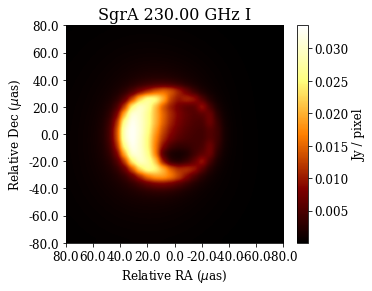

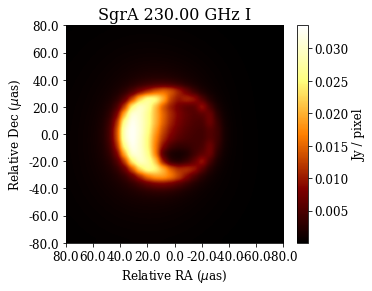

In [6]:
im.display()

# Generate Dataset

In [16]:
# Constants
tint_sec = 5
tadv_sec = 600
tstart_hr = 0
tstop_hr = 24
bw_hz = 4e9

n = 10
INPUT_SIZE = 2060
AMP_INPUT_SIZE = 1030
CPHASE_INPUT_SIZE = 1307
OUTPUT_SIZE = 784

# Gaussian thermal error
add_th_noise = True
ampcal = True
phasecal = True

In [17]:
# The inputs are the visibilities, outputs are the images
train_inputs_old, train_outputs = np.empty([n, INPUT_SIZE]), np.empty([n, OUTPUT_SIZE])
train_inputs_amp_and_cphase = np.empty([n, AMP_INPUT_SIZE + CPHASE_INPUT_SIZE])

eht = eh.array.load_txt('../arrays/EHT2017.txt')

# train_images in this loop refers to training images for fashion MNIST 
# dataset
for i in range(len(train_images[:10])):
    # Current fashion MNIST image
    input_image = train_images[i]
    
    # Base ehtim image
    im = eh.image.load_txt('../models/avery_sgra_eofn.txt')
    
    # Resize to 28 x 28
    resized_im = im.resample_square(28)
    
    # Remove 0s in fashion MNIST image
    input_image_copy = input_image.copy()
    input_image_copy[input_image_copy == 0] = 1
    
    # Normalize fashion MNIST image
    total = np.sum(input_image_copy)
    input_image_copy = input_image_copy / total
    
    # Copy image over to ehtim image object
    resized_im.imvec = input_image_copy.flatten()
    
    # Generate observations
    obs = resized_im.observe(eht, tint_sec, tadv_sec, tstart_hr, tstop_hr, bw_hz,
                 ttype='direct', sgrscat=False, ampcal=ampcal, phasecal=phasecal, 
                 add_th_noise=add_th_noise)
    
    # Write image and obs out to file and store
    vis = obs.data['vis']
    real_comp = vis.real
    imag_comp = vis.imag
    train_inputs_old[i] = np.concatenate((real_comp, imag_comp))
    
    obs.add_amp()
    obs.add_cphase()
    train_inputs_amp_and_cphase[i] = np.concatenate((obs.amp['amp'], obs.cphase['cphase']))
    
    train_outputs[i] = resized_im.imvec
    

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

In [18]:
print(train_inputs_old)

[[ 1.02877553 -0.02182207  0.02078363 ... -0.01786172  0.01497555
   0.0136685 ]
 [ 0.98279288  0.01847174  0.01908123 ...  0.00698149 -0.00359519
   0.00282106]
 [ 0.98986953  0.00891677  0.00480467 ... -0.03277693  0.02625182
  -0.01374759]
 ...
 [ 1.00502987 -0.00345094  0.01591215 ... -0.03811304 -0.00873906
   0.05297134]
 [ 1.00763251  0.09281266  0.0991457  ... -0.01559093  0.06224169
  -0.06620854]
 [ 0.97905338  0.04128406 -0.00407311 ... -0.01006073  0.03068821
  -0.03321212]]


In [25]:
print(train_inputs_amp_and_cphase)

[[ 1.02945456e+00  3.64002325e-02  2.20055872e-02 ... -1.61987837e+01
  -1.49043184e+02 -1.64987011e+02]
 [ 9.82566436e-01  1.98863636e-02  2.20055872e-02 ... -1.24063930e+02
  -2.72643198e+01  2.83652882e+01]
 [ 9.89633854e-01  3.15235558e-02  2.20055872e-02 ...  8.82307660e+00
   1.28815393e+02 -5.25763758e+01]
 ...
 [ 1.00540450e+00  2.24105364e-02  2.20055872e-02 ...  1.45738073e+02
  -9.47724422e+01 -6.15772948e+01]
 [ 1.00756102e+00  1.17603575e-01  9.82415511e-02 ...  1.08061083e+01
  -1.25382950e+01  4.97555686e+00]
 [ 9.78937085e-01  3.80049158e-02  2.63642758e-02 ...  4.56640356e+00
   2.87278891e+01 -1.21967956e+01]]


In [26]:
print(train_outputs)

[[1.30551712e-05 1.30551712e-05 1.30551712e-05 ... 1.30551712e-05
  1.30551712e-05 1.30551712e-05]
 [1.17792567e-05 1.17792567e-05 1.17792567e-05 ... 1.17792567e-05
  1.17792567e-05 1.17792567e-05]
 [3.43441975e-05 3.43441975e-05 3.43441975e-05 ... 3.43441975e-05
  3.43441975e-05 3.43441975e-05]
 ...
 [8.66446012e-06 8.66446012e-06 8.66446012e-06 ... 6.06512208e-04
  8.66446012e-06 8.66446012e-06]
 [4.89644029e-05 4.89644029e-05 4.89644029e-05 ... 4.89644029e-05
  4.89644029e-05 4.89644029e-05]
 [2.42918914e-05 2.42918914e-05 2.42918914e-05 ... 2.42918914e-05
  2.42918914e-05 2.42918914e-05]]


# Generate Full Dataset with Gaussian Thermal Error

In [29]:
# Constants
tint_sec = 5
tadv_sec = 600
tstart_hr = 0
tstop_hr = 24
bw_hz = 4e9

n = 60000
INPUT_SIZE = 2060
AMP_INPUT_SIZE = 1030
CPHASE_INPUT_SIZE = 1307
OUTPUT_SIZE = 784

# Gaussian thermal error
add_th_noise = True
ampcal = True
phasecal = True # set false for atmospheric

In [30]:
# The inputs are the visibilities, outputs are the images
train_inputs_old, train_outputs = np.empty([n, INPUT_SIZE]), np.empty([n, OUTPUT_SIZE])
train_inputs_amp_and_cphase = np.empty([n, AMP_INPUT_SIZE + CPHASE_INPUT_SIZE])

eht = eh.array.load_txt('../arrays/EHT2017.txt')

# train_images in this loop refers to training images for fashion MNIST 
# dataset
for i in range(len(train_images)):
    if i % 100 == 0:
        print("\n\n**********IMAGE {}**********\n\n".format(i))
        
    # Current fashion MNIST image
    input_image = train_images[i]
    
    # Base ehtim image
    im = eh.image.load_txt('../models/avery_sgra_eofn.txt')
    
    # Resize to 28 x 28
    resized_im = im.resample_square(28)
    
    # Remove 0s in fashion MNIST image
    input_image_copy = input_image.copy()
    input_image_copy[input_image_copy == 0] = 1
    
    # Normalize fashion MNIST image
    total = np.sum(input_image_copy)
    input_image_copy = input_image_copy / total
    
    # Copy image over to ehtim image object
    resized_im.imvec = input_image_copy.flatten()
    
    # Generate observations
    obs = resized_im.observe(eht, tint_sec, tadv_sec, tstart_hr, tstop_hr, bw_hz,
                 ttype='direct', sgrscat=False, ampcal=ampcal, phasecal=phasecal, 
                 add_th_noise=add_th_noise)
    
    # Write image and obs out to file and store
    vis = obs.data['vis']
    real_comp = vis.real
    imag_comp = vis.imag
    train_inputs_old[i] = np.concatenate((real_comp, imag_comp))
    
    obs.add_amp()
    obs.add_cphase()
    train_inputs_amp_and_cphase[i] = np.concatenate((obs.amp['amp'], obs.cphase['cphase']))
    
    train_outputs[i] = resized_im.imvec



**********IMAGE 0**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/a

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 300**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 600**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation f

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 900**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 1200**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagin

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 1500**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagin

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 1800**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagin

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 2100**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagin

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 2400**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 13000**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 13300**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 13600**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 13900**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 14200**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 14500**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 14800**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 20900**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 21200**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 21500**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 21800**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 22100**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 36300**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 36600**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 36900**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra


Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 37200**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 37500**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 37800**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 38100**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 38400**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 38700**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra


Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 44200**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 44500**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 44800**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 45100**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 45400**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 45700**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 46000**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 46300**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 46600**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 46900**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 47200**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 47500**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 47800**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 48100**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 48400**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 48700**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 49000**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 49300**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 49600**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 49900**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 50200**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 50500**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 50800**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 51100**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 51400**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 51700**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 52000**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 52300**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 52600**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 52900**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 53200**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 53500**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 53800**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 54100**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 54400**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 54700**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averagi

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 55000**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating em

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibra

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating e

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 59600**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Ad

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s



**********IMAGE 59900**********


Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors t

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000

Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibil

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated 

Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.000000 s

Getting bispectra:: type vis, count max, scan 107/107 

Updated self.cphase: no averaging
updated self.cphase: avg_time 0.000000 s

Loading text image:  ../models/avery_sgra_eofn.txt
Generating empty observation file . . . 
Producing clean visibilities from image with direct FT . . . 
Adding gain + phase errors to data and applying a priori calibration . . . 
Adding thermal noise to data . . . 
Updated self.amp: no averaging
Updated self.amp: avg_time 0.0000